In [2]:
import pandas as pd
import numpy as np
import networkx as nx
import matplotlib.pyplot as plt

In [4]:
df = pd.read_csv("actor_edgelist.csv",
    sep=",",
    names=["start_node", "end_node"])

In [5]:
G = nx.from_pandas_edgelist(df, "start_node", "end_node")

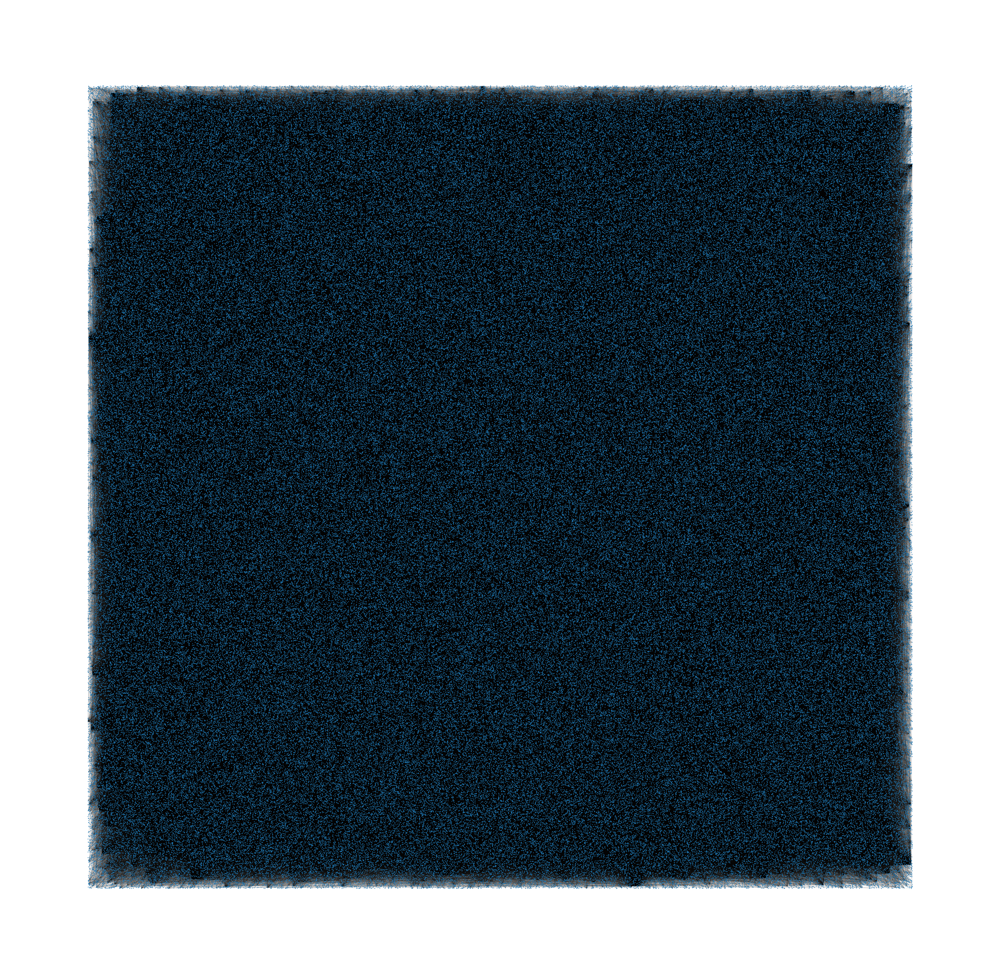

In [74]:
fig, ax = plt.subplots(figsize=(99, 99))
ax.axis("off")
plot_options = {"node_size": 10, "with_labels": False, "width": 0.15}
nx.draw_networkx(G, pos=nx.random_layout(G), ax=ax, **plot_options)

In [7]:
print('Number of Nodes', G.number_of_nodes())
print('No of edges', G.number_of_edges())

Number of Nodes 344826
No of edges 1048576


In [8]:
np.mean([d for _, d in G.degree()])

6.081768776136371

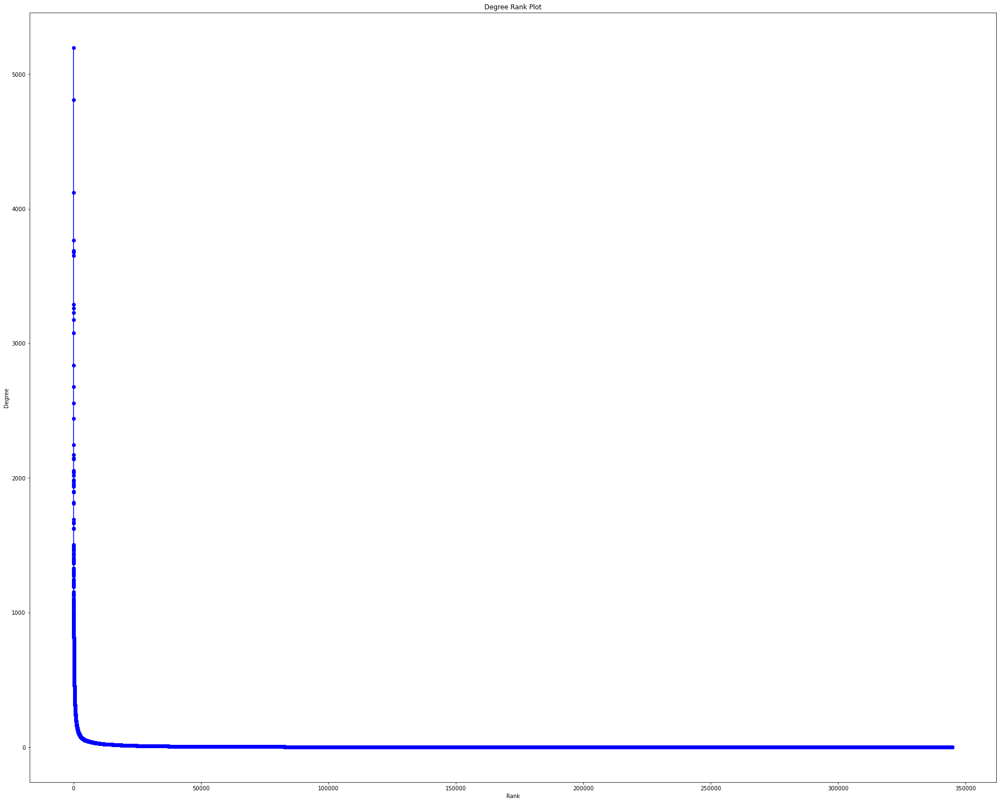

In [9]:
degree_sequence = sorted((d for n, d in G.degree()), reverse=True)
dmax = max(degree_sequence)

fig = plt.figure("Degree of a random graph", figsize=(50, 50))
# Create a gridspec for adding subplots of different sizes
axgrid = fig.add_gridspec(5, 4)

ax1 = fig.add_subplot(axgrid[3:, :2])
ax1.plot(degree_sequence, "b-", marker="o")
ax1.set_title("Degree Rank Plot")
ax1.set_ylabel("Degree")
ax1.set_xlabel("Rank")


fig.tight_layout()
plt.show()

**Let's calculate the frequencies of degrees**

Text(0, 0.5, 'Frequency')

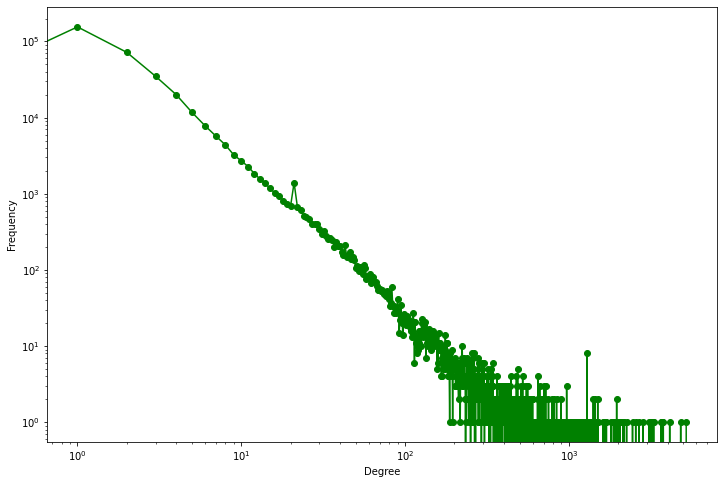

In [10]:
degree_freq = nx.degree_histogram(G)
degrees = range(len(degree_freq))
plt.figure(figsize=(12, 8)) 
plt.loglog(degrees, degree_freq,'go-') 
plt.xlabel('Degree of Nodes')
plt.ylabel('Number of Actors')

- Nodes with less degree are high
- Decreases very fast

In [45]:
clusters =nx.clustering(G)

In [55]:
degrees = [val for (node, val) in G.degree()]
degrees = np.array(degrees)

In [58]:
print(type(clusters_val))
print(type(degrees))

<class 'numpy.ndarray'>
<class 'numpy.ndarray'>


In [64]:
len(clusters)

344826

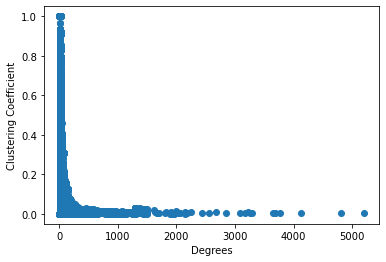

In [73]:
fig, ax = plt.subplots()
plt.scatter(degrees, clusters.values())
ax.set_xlabel('Degrees')
ax.set_ylabel('Clustering Coefficient')
plt.show()

In [75]:
shortest_path_lengths = dict(nx.all_pairs_shortest_path_length(G))

MemoryError: 

In [10]:
shortest_path_lengths[0][42]

NameError: name 'shortest_path_lengths' is not defined

In [11]:
diameter = max(nx.eccentricity(G, sp=shortest_path_lengths).values())
diameter

NameError: name 'shortest_path_lengths' is not defined

In [76]:
nx.average_clustering(G)

0.30201831886577607

Text(0, 0.5, 'Counts')

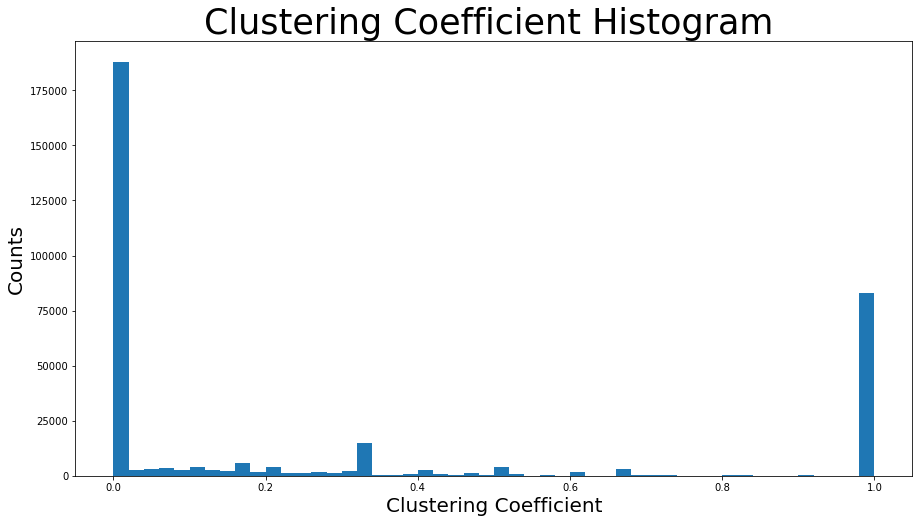

In [77]:
plt.figure(figsize=(15, 8))
plt.hist(nx.clustering(G).values(), bins=50)
plt.title("Clustering Coefficient Histogram ", fontdict={"size": 35}, loc="center")
plt.xlabel("Clustering Coefficient", fontdict={"size": 20})
plt.ylabel("Counts", fontdict={"size": 20})